In [1]:
import pandas as pd
import os
import numpy as np
import glob
from scipy.stats import zscore
import matplotlib.pyplot as plt
from visualizing_training.hmm import HMM
from visualizing_training.visualize import visualize_states, visualize_avg_log_likelihood, visualize_hmm_loss
from visualizing_training.utils import training_run_json_to_csv, save_model, munge_data, load_model
pd.set_option('display.max_rows', 500)

In [2]:
def pizza_clock_classification(grad_sym_list, dist_irr_list, grad_sym_thresh=0.8, dist_irr_thresh=0.6):
    
    final_output = np.where(grad_sym_list>=grad_sym_thresh,"pizza",
                            np.where(dist_irr_list >=dist_irr_thresh,"clock",
                                     "pizza"))
    
    return final_output

In [3]:
parent_dir = "all_metrics"

In [4]:
def create_difference_df(df):
    new_df = pd.DataFrame()
    new_df[df.columns[:2].tolist()] = df[df.columns[:2].tolist()]
    cols = df.columns[2:]
    for col in cols:
        new_col = col + "_diff"
        new_df[new_col] = df[col] - df[col].shift(-1)
    
    return new_df

for data_dir in glob.glob(parent_dir + '/'+  "*modular_clock_pizza_run*"):
    
    for filename in glob.glob(data_dir + "/*.csv"):
        attn = filename.split("/")[1].split("_")[-1]
        
        df = pd.read_csv(filename)
        new_df = create_difference_df(df)
        new_df['attn'] = attn
        new_df['grad_sym'] = df['grad_sym']
        new_df['dist_irr'] = df['dist_irr']
        new_df.dropna(inplace = True)
        new_filename = filename.split("/")[2].split(".csv")[0] + f"_attn{attn}" + ".csv"
        new_df.to_csv(parent_dir + "/combined_attention_difference/" + new_filename, index = False)
        if not os.path.isdir(parent_dir + '/'+  f"modular_clock_pizza_diff_run_{attn}"):
            os.mkdir(parent_dir + '/'+  f"modular_clock_pizza_diff_run_{attn}")
        new_df.to_csv(parent_dir + '/'+  f"modular_clock_pizza_diff_run_{attn}" + '/' + filename.split("/")[2],index = False)

## Combined Attention with all metrics

In [6]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

first_n = 400
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
data_dir = parent_dir + f"/combined_attention_difference/"
hmm_output = hmm_model.get_avg_log_likelihood(data_dir, cols)

visualize_avg_log_likelihood(hmm_output,"all metrics - modular_clock_pizza_diff_run_combined_attention_difference")

model_path = data_dir + '/model_all_metrics'
save_model(model_path,hmm_output)

all_metrics/combined_attention_difference/
['all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn1.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed2_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed3_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn1.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed3_scaling1.0_attn0.2.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed2_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.6.csv'

100%|██████████| 8/8 [00:15<00:00,  1.98s/it]


In [56]:
hmm_model.best_model

GaussianHMM(n_components=8)

In [7]:
hmm_output['best_models'][2]

GaussianHMM(n_components=3)

[4 5]


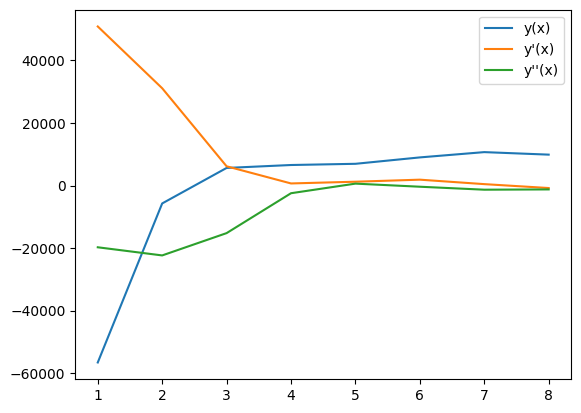

In [6]:
da = np.gradient(hmm_output['mean_scores'],1)
dda = np.gradient(da,1)
x = np.arange(1, max_components + 1)
x_zero_index = np.where(np.diff(np.sign(dda)))[0]
print(x[x_zero_index])

plt.plot(x, hmm_output['mean_scores'], label="y(x)")
plt.plot(x, da, label="y'(x)")
plt.plot(x, dda, label="y''(x)")
plt.legend()
plt.show()

## All metrics, more components


### All metrics, attention = 0

In [152]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0/
['all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
6696.723822995462


In [167]:
state_transitions['2>>5'],state_transitions['5>>2']

({'cols': ['dist_irr_diff', 'eval_accuracy_diff', 'train_loss_diff'],
  'feature_changes': [-0.4240452251989205,
   0.8771076149913003,
   -5.319382436051609,
   -0.5511394608986726,
   -0.8749932977954866,
   0.7184774566046112,
   3.7809065205637364,
   1.742914845696474,
   2.920091694324984,
   4.396951704345772,
   2.672057180020996,
   4.58677978548293,
   4.5811549520632635,
   3.971855820640052,
   -2.324950352315685,
   4.824745064528559,
   4.104552501298888,
   -1.9164648047914472,
   4.78936062343515,
   -3.531019255405657]},
 {'cols': ['l1_diff', 'var_w_diff', 'l2_diff'],
  'feature_changes': [-4.5811549520632635,
   -4.58677978548293,
   -4.396951704345772,
   -4.824745064528559,
   -3.7809065205637364,
   -3.971855820640052,
   -4.78936062343515,
   -4.104552501298888,
   -1.742914845696474,
   -0.8771076149913003,
   -2.672057180020996,
   -2.920091694324984,
   -0.7184774566046112,
   0.5511394608986726,
   0.8749932977954866,
   3.531019255405657,
   1.916464804791447

In [244]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

#### reason for 4>>6 transition

In [168]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='dist_irr_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_b_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l1_diff')

### All metrics, attention = 0.2

In [317]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.2
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.2/
['all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
2369.9371288451716


In [325]:
state_transitions['5>>3'],state_transitions['3>>5']

({'cols': ['train_accuracy_diff', 'train_loss_diff', 'code_sparsity_diff'],
  'feature_changes': [1.8455627402003478,
   -1.33499212914184,
   -0.02313915073761308,
   -0.2490689581925775,
   -0.6011523979310285,
   2.53487321877883,
   0.770992805350326,
   0.9028782387648139,
   -0.600422114953408,
   0.0867203789004635,
   0.12011721030185385,
   0.4512487465729718,
   2.1306227324372053,
   1.6071116209377538,
   0.7501117530339243,
   2.0883707059858994,
   2.0731147705166326,
   1.2559603090025286,
   2.2588912715544334,
   2.1307640985648453]},
 {'cols': ['eval_loss_diff', 'var_b_diff', 'train_accuracy_diff'],
  'feature_changes': [-1.6071116209377538,
   -1.2559603090025286,
   -1.8455627402003478,
   0.02313915073761308,
   -0.770992805350326,
   -2.1307640985648453,
   -2.53487321877883,
   -2.1306227324372053,
   -2.0731147705166326,
   -0.12011721030185385,
   -2.0883707059858994,
   -2.2588912715544334,
   -0.4512487465729718,
   -0.0867203789004635,
   0.6011523979310285,

In [323]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [324]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')


### All metrics, attention = 0.4

In [311]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.4
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.4/
['all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
10261.891353058676


In [316]:
state_transitions['5>>2']

{'cols': ['l1_diff', 'var_w_diff', 'l2_diff'],
 'feature_changes': [-4.5811549520632635,
  -4.58677978548293,
  -4.396951704345772,
  5.319382436051609,
  -4.824745064528559,
  -3.7809065205637364,
  2.324950352315685,
  3.531019255405657,
  0.5511394608986726,
  0.8749932977954866,
  -0.7184774566046112,
  1.9164648047914472,
  -0.8771076149913003,
  -2.920091694324984,
  -1.742914845696474,
  -2.672057180020996,
  0.4240452251989205,
  -3.971855820640052,
  -4.104552501298888,
  -4.78936062343515]}

In [315]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, attention = 0.6

In [299]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.6
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.6/
['all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
11000.685154846575


In [304]:
state_transitions['3>>5'],state_transitions['4>>3']

({'cols': ['eval_loss_diff', 'var_b_diff', 'code_sparsity_diff'],
  'feature_changes': [-1.6071116209377538,
   -1.2559603090025286,
   0.02313915073761308,
   -1.8455627402003478,
   -0.770992805350326,
   -2.53487321877883,
   -2.1307640985648453,
   -2.1306227324372053,
   -2.0731147705166326,
   -0.12011721030185385,
   -2.0883707059858994,
   -0.4512487465729718,
   -2.2588912715544334,
   0.6011523979310285,
   -0.0867203789004635,
   0.600422114953408,
   -0.7501117530339243,
   0.2490689581925775,
   1.33499212914184,
   -0.9028782387648139]},
 {'cols': ['train_accuracy_diff', 'code_sparsity_diff', 'eval_accuracy_diff'],
  'feature_changes': [0.0007912789453204117,
   -0.9077438703728782,
   -0.17399008964814464,
   0.10784345589872857,
   -0.0293010012470081,
   -0.013415330892691521,
   0.0002953088282611361,
   -0.01922224389660976,
   -0.044867213104243846,
   -0.3526089236941655,
   -0.21003984689688654,
   0.12701056140200276,
   1.122102478921391,
   0.22073645323988045,

In [310]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [305]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_w_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='code_sparsity_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy_diff')

### All metrics, attention = 0.8

In [72]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.8
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.8/
['all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
10805.834510772318


In [73]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, attention = 1

In [74]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 1
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_1/
['all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
9778.23339668752


In [75]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

## All metrics, less components

### All metrics, less components, attention = 0

In [8]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=7)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0/
['all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
1137.540799834948


In [9]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, less components, attention = 0.2

In [10]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.2
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=7)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.2/
['all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
-885.7464283210163


In [11]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, less components, attention = 0.4

In [12]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.4
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=7)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.4/
['all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
6628.679435356902


In [13]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, less components, attention = 0.6

In [14]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.6
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=7)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.6/
['all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
6198.7276398243985


In [16]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, less components, attention = 0.8

In [18]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.8
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=7)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.8/
['all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
6295.068585855568


In [19]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### All metrics, less components, attention = 1

In [22]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff','grad_sym_diff',
       'dist_irr_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 1
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=7)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_1/
['all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
4843.108985949477


In [23]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

## Combined Attention with old metrics

In [24]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

first_n = 400
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
data_dir = parent_dir + f"/combined_attention_difference/"
hmm_output = hmm_model.get_avg_log_likelihood(data_dir, cols)

visualize_avg_log_likelihood(hmm_output,"old metrics - modular_clock_pizza_diff_run_combined_attention_difference")

model_path = data_dir + '/model_old_metrics'
save_model(model_path,hmm_output)

all_metrics/combined_attention_difference/
['all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn1.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed2_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed3_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn1.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed3_scaling1.0_attn0.2.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed2_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.6.csv'

100%|██████████| 8/8 [00:18<00:00,  2.30s/it]


In [84]:
hmm_model.best_model

GaussianHMM(n_components=8)

In [85]:
hmm_output['best_models']

[GaussianHMM(),
 GaussianHMM(n_components=2),
 GaussianHMM(n_components=3),
 GaussianHMM(n_components=4),
 GaussianHMM(n_components=5),
 GaussianHMM(n_components=6),
 GaussianHMM(n_components=6),
 GaussianHMM(n_components=8)]

[4 5 7]


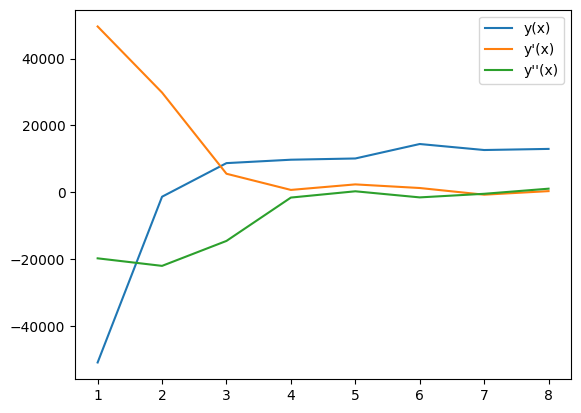

In [12]:
da = np.gradient(hmm_output['mean_scores'],1)
dda = np.gradient(da,1)
x = np.arange(1, max_components + 1)
x_zero_index = np.where(np.diff(np.sign(dda)))[0]
print(x[x_zero_index])

plt.plot(x, hmm_output['mean_scores'], label="y(x)")
plt.plot(x, da, label="y'(x)")
plt.plot(x, dda, label="y''(x)")
plt.legend()
plt.show()

## Old metrics, more components

### Old metrics, attention = 0

In [288]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0/
['all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
7991.161625981154


In [292]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Old Metrics, attention = 0.2

In [293]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.2
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.2/
['all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
5840.89028656429


In [296]:
state_transitions['3>>2']

{'cols': ['train_loss_diff', 'train_accuracy_diff', 'eval_loss_diff'],
 'feature_changes': [-5.394040720900447,
  6.093393797753388,
  -0.301883559269441,
  -1.2403545957167543,
  -0.24559402524742194,
  0.5173874068972172,
  -0.8627535701673017,
  2.6781244275743985,
  4.216591277117435,
  4.90461807768634,
  5.321995884687331,
  4.612236038636977,
  -2.047368652712072,
  5.302365734218233,
  5.77335797401561,
  5.301805438557085,
  4.54433901746395,
  0.11799332925787281]}

In [297]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [298]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')

### Old metrics, attention = 0.4

In [273]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.4
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.4/
['all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
12754.038984504305


In [287]:
state_transitions['3>>2'],state_transitions['0>>3']

({'cols': ['eval_loss_diff', 'train_accuracy_diff', 'eval_accuracy_diff'],
  'feature_changes': [-0.301883559269441,
   6.093393797753388,
   0.11799332925787281,
   4.54433901746395,
   5.301805438557085,
   5.77335797401561,
   2.6781244275743985,
   -2.047368652712072,
   4.90461807768634,
   -5.394040720900447,
   5.321995884687331,
   4.216591277117435,
   5.302365734218233,
   -1.2403545957167543,
   -0.8627535701673017,
   -0.24559402524742194,
   4.612236038636977,
   0.5173874068972172]},
 {'cols': ['l1_diff', 'var_w_diff', 'l2_diff'],
  'feature_changes': [-5.876845390699579,
   -5.454561306817067,
   -5.451363127045806,
   -4.797168101394219,
   -6.090960891817352,
   -4.306591111810703,
   -0.11233251611211517,
   -4.422551617835924,
   -4.403667900132167,
   -4.971012329087131,
   -2.7910527086443335,
   -0.5266534116083912,
   0.029175333208239923,
   1.1310942056734887,
   0.29364112044427204,
   1.894679801761621,
   3.539717199823722,
   5.386692677288696]})

In [285]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

#### 1>>4 and 4>>3 is due to dip in l1_diff and l2_diff. 3>>2 is due to dip and spike in train and eval loss diff

In [281]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')

### Old metrics, attention = 0.6

In [259]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.6
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.6/
['all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
12939.856234075705


In [270]:
state_transitions['3>>2'],state_transitions['0>>3'] 

({'cols': ['train_accuracy_diff', 'var_b_diff', 'var_w_diff'],
  'feature_changes': [6.093393797753388,
   4.54433901746395,
   5.301805438557085,
   5.77335797401561,
   2.6781244275743985,
   4.612236038636977,
   -5.394040720900447,
   -2.047368652712072,
   5.321995884687331,
   4.90461807768634,
   4.216591277117435,
   5.302365734218233,
   -0.8627535701673017,
   -1.2403545957167543,
   -0.24559402524742194,
   -0.301883559269441,
   0.5173874068972172,
   0.11799332925787281]},
 {'cols': ['l1_diff', 'var_w_diff', 'l2_diff'],
  'feature_changes': [-5.876845390699579,
   -5.454561306817067,
   -5.451363127045806,
   -4.797168101394219,
   -0.11233251611211517,
   -6.090960891817352,
   -4.306591111810703,
   -4.422551617835924,
   -4.403667900132167,
   -4.971012329087131,
   -2.7910527086443335,
   -0.5266534116083912,
   0.029175333208239923,
   1.1310942056734887,
   1.894679801761621,
   0.29364112044427204,
   3.539717199823722,
   5.386692677288696]})

In [265]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [271]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_b_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_w_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l1_diff')

### Old metrics, attention = 0.8

In [254]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 0.8
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_0.8/
['all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
13469.200215712423


In [255]:
state_transitions['1>>2'],state_transitions['2>>1']

({'cols': ['train_loss_diff', 'eval_accuracy_diff', 'eval_loss_diff'],
  'feature_changes': [-3.0329005641351974,
   8.060657791922706,
   -6.302610264054957,
   5.456431161537129,
   4.142578429002306,
   4.028459904604575,
   2.6658777427454536,
   4.046074752240448,
   5.120275902827222,
   3.5171989743367726,
   1.424804256909869,
   3.578404416600077,
   1.0678268043985948,
   -0.6408716773067208,
   -0.4527124854057027,
   1.3662587888081275,
   2.4272041466855576,
   1.1724980434142909]},
 {'cols': ['eval_loss_diff', 'mean_b_diff', 'train_loss_diff'],
  'feature_changes': [6.302610264054957,
   -1.424804256909869,
   3.0329005641351974,
   -3.5171989743367726,
   -1.1724980434142909,
   0.4527124854057027,
   -1.0678268043985948,
   0.6408716773067208,
   -1.3662587888081275,
   -2.6658777427454536,
   -2.4272041466855576,
   -8.060657791922706,
   -3.578404416600077,
   -4.046074752240448,
   -4.028459904604575,
   -5.456431161537129,
   -4.142578429002306,
   -5.12027590282722

In [256]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [257]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')

### Old metrics, attention = 1

In [245]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 6
attn = 1
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=6)
all_metrics/modular_clock_pizza_diff_run_1/
['all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
12781.660908215248


In [252]:
state_transitions['1>>2'],state_transitions['2>>1']

({'cols': ['train_loss_diff', 'eval_accuracy_diff', 'eval_loss_diff'],
  'feature_changes': [-3.0329005641351974,
   8.060657791922706,
   -6.302610264054957,
   2.6658777427454536,
   5.456431161537129,
   4.142578429002306,
   4.028459904604575,
   4.046074752240448,
   5.120275902827222,
   3.5171989743367726,
   -0.4527124854057027,
   1.424804256909869,
   -0.6408716773067208,
   1.0678268043985948,
   3.578404416600077,
   2.4272041466855576,
   1.1724980434142909,
   1.3662587888081275]},
 {'cols': ['eval_loss_diff', 'mean_b_diff', 'train_loss_diff'],
  'feature_changes': [6.302610264054957,
   -1.424804256909869,
   3.0329005641351974,
   -3.5171989743367726,
   -1.0678268043985948,
   -1.1724980434142909,
   -1.3662587888081275,
   0.4527124854057027,
   0.6408716773067208,
   -2.6658777427454536,
   -2.4272041466855576,
   -8.060657791922706,
   -3.578404416600077,
   -4.046074752240448,
   -4.028459904604575,
   -5.456431161537129,
   -4.142578429002306,
   -5.12027590282722

In [249]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [253]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')

## Old metrics, less components

### Old metrics, less components, attention = 0

In [26]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0/
['all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
3751.31429338012


In [27]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Old metrics, less components, attention = 0.2

In [28]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.2
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.2/
['all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
155.22960842648274


In [29]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Old metrics, less components, attention = 0.4

In [30]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.4
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.4/
['all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
8173.924469715492


In [31]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Old metrics, less components, attention = 0.6

In [32]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.6
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.6/
['all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
8110.963693094117


In [33]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Old metrics, less components, attention = 0.8

In [34]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.8
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.8/
['all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
8553.881274436577


In [41]:
state_transitions['0>>1']

{'cols': ['train_loss_diff', 'train_accuracy_diff', 'mean_b_diff'],
 'feature_changes': [-0.443226608906046,
  0.3760739965672752,
  0.1995688510984331]}

In [44]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [48]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='mean_b_diff')

### Old metrics, less components, attention = 1

In [49]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff', 'trace_diff', 'spectral_diff', 'code_sparsity_diff',
       'computational_sparsity_diff', 'mean_lambda_diff', 'variance_lambda_diff', 'mean_w_diff',
       'median_w_diff', 'var_w_diff', 'mean_b_diff', 'median_b_diff', 'var_b_diff', 'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 1
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_1/
['all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
8458.880880372935


In [50]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

## Combined attention with select metrics

In [51]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']
first_n = 400
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
data_dir = parent_dir + f"/combined_attention_difference/"
hmm_output = hmm_model.get_avg_log_likelihood(data_dir, cols)

visualize_avg_log_likelihood(hmm_output,"select metrics - modular_clock_pizza_diff_run_combined_attention_difference")

model_path = data_dir + '/model_select_metrics'
save_model(model_path,hmm_output)

all_metrics/combined_attention_difference/
['all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn1.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed2_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed3_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn1.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed1_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed3_scaling1.0_attn0.2.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed2_scaling1.0_attn0.csv', 'all_metrics/combined_attention_difference/lr0.001_adamw_seed0_scaling1.0_attn0.6.csv'

100%|██████████| 8/8 [00:14<00:00,  1.86s/it]


In [132]:
hmm_model.best_model

GaussianHMM(n_components=8)

In [139]:
hmm_output['best_models'][4]

GaussianHMM(n_components=5)

## Select metrics, more components

### Select metrics, attention = 0

In [140]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 5
attn = 0
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=5)
all_metrics/modular_clock_pizza_diff_run_0/
['all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
14274.957244509196


In [141]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, attention = 0.2

In [214]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 5
attn = 0.2
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=5)
all_metrics/modular_clock_pizza_diff_run_0.2/
['all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
12939.202639826655


In [237]:
state_transitions['4>>2']

{'cols': ['l1_diff', 'var_w_diff', 'variance_lambda_diff'],
 'feature_changes': [-3.586493092881959,
  -3.9085990179039274,
  -3.5567131206902562,
  -8.457933105046898,
  -3.2973019112871667,
  -3.5943327730505366,
  3.806058727242346,
  6.324624748477022]}

In [242]:
random_seed = 2
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

In [243]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_w_diff')

In [235]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='variance_lambda_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l1_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l1_diff')

#### 2>>1 transition is due to dip in variance lambda

In [226]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='variance_lambda_diff')

### Select metrics, attention = 0.4

In [204]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 5
attn = 0.4
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=5)
all_metrics/modular_clock_pizza_diff_run_0.4/
['all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
16711.656021036633


In [210]:
state_transitions['1>>0'],state_transitions['0>>4'],state_transitions['4>>0']

({'cols': ['eval_loss_diff', 'eval_accuracy_diff', 'train_accuracy_diff'],
  'feature_changes': [1.2321686755294927,
   0.01026429067163856,
   2.994692602341206,
   -2.093277808833397,
   2.5973129616537274,
   3.0039497499376795,
   2.1852565528942054,
   2.7443600838736817]},
 {'cols': ['variance_lambda_diff',
   'eval_accuracy_diff',
   'train_accuracy_diff'],
  'feature_changes': [-1.8782077040069678,
   -1.3137152304047461,
   -0.20801682626253612,
   -1.0202350599763435,
   -0.7057666638313631,
   -0.8988679812889375,
   1.4421645298379004,
   0.3753393306994036]},
 {'cols': ['train_accuracy_diff', 'train_loss_diff', 'eval_loss_diff'],
  'feature_changes': [0.20801682626253612,
   -0.3753393306994036,
   -1.4421645298379004,
   1.3137152304047461,
   1.0202350599763435,
   1.8782077040069678,
   0.8988679812889375,
   0.7057666638313631]})

In [208]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

#### 2>>1 is happening due to drop in variance_lambda_diff, 1>>5 & 5>>1 is due to sudden drop and increase in eval_loss_diff

In [211]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='variance_lambda_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy_diff')

### Select metrics, attention = 0.6

In [192]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 5
attn = 0.6
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=5)
all_metrics/modular_clock_pizza_diff_run_0.6/
['all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
18753.88096578731


In [201]:
state_transitions['1>>0'],state_transitions['0>>1']

({'cols': ['eval_loss_diff', 'train_loss_diff', 'variance_lambda_diff'],
  'feature_changes': [1.2321686755294927,
   -2.093277808833397,
   2.1852565528942054,
   2.7443600838736817,
   3.0039497499376795,
   2.5973129616537274,
   0.01026429067163856,
   2.994692602341206]},
 {'cols': ['eval_accuracy_diff', 'train_loss_diff', 'variance_lambda_diff'],
  'feature_changes': [-0.01026429067163856,
   2.093277808833397,
   -2.1852565528942054,
   -2.994692602341206,
   -2.7443600838736817,
   -3.0039497499376795,
   -2.5973129616537274,
   -1.2321686755294927]})

In [199]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

#### transition from 2>>1 is happening due to drop in variance_lambda_diff

In [203]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy_diff')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='variance_lambda_diff')

### Select metrics, attention = 0.8

In [182]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 5
attn = 0.8
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=5)
all_metrics/modular_clock_pizza_diff_run_0.8/
['all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
19570.0260504955


In [186]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, attention = 1

In [187]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 5
attn = 1
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=5)
all_metrics/modular_clock_pizza_diff_run_1/
['all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
17634.56892413849


In [191]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

## Select metrics, less components

### Select metrics, less components,attention = 0

In [52]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0/
['all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
12653.952275263733


In [53]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, less components,attention = 0.2

In [55]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.2
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.2/
['all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
10466.102513057405


In [56]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, less components,attention = 0.4

In [57]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.4
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.4/
['all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
15545.076297899872


In [58]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, less components,attention = 0.6

In [59]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.6
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.6/
['all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
17154.891073221374


In [60]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, less components,attention = 0.8

In [61]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 0.8
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_0.8/
['all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
17975.09892570544


In [62]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')

### Select metrics, less components,attention = 1

In [63]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1_diff', 'l2_diff',  
        'variance_lambda_diff', 
       'var_w_diff',   
        'train_loss_diff', 'eval_loss_diff', 'train_accuracy_diff',
       'eval_accuracy_diff']

n_components = 3
attn = 1
data_dir = parent_dir + f"/combined_attention_difference/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])

attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_states(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention_difference/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=3)
all_metrics/modular_clock_pizza_diff_run_1/
['all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_diff_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
16065.853697305076


In [64]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_diff_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2_diff')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2_diff')